In [0]:
!pip install git+https://github.com/pabloppp/pytorch-tools -U

In [0]:
import torch
import torchvision
from torch import nn, optim
from torch.utils.data import DataLoader, SubsetRandomSampler
from torchtools.vq import VectorQuantize
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML
from PIL import Image

In [0]:
from google.colab import drive
drive.mount('/content/gdrive')

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).


In [0]:
dataset = torchvision.datasets.STL10('data', split='unlabeled', transform=torchvision.transforms.ToTensor(), download=True)
sampler = SubsetRandomSampler(range(40000))
dataloader = DataLoader(dataset, batch_size=16, sampler=sampler)
print(len(dataset), len(dataloader))

Files already downloaded and verified
100000 2500


torch.Size([16, 3, 96, 96])


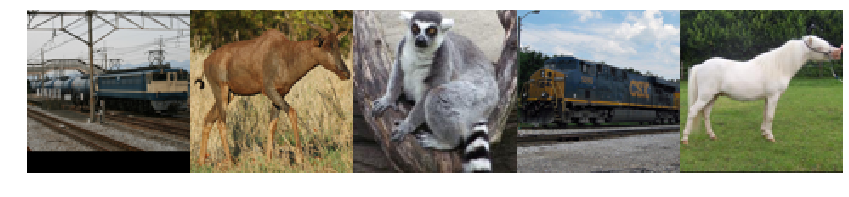

In [0]:
def show_images(image_list):
    images = torch.cat(image_list, dim=-1)   
    plt.imshow(images.permute(1,2,0))
    plt.axis('off')
    plt.rcParams["figure.figsize"] = (3*len(image_list), 3)
    plt.show()

images, _ = next(iter(dataloader))
print(images.shape)
show_images([b for b in images[:5]])

In [0]:
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        try:
            nn.init.xavier_uniform_(m.weight.data)
            m.bias.data.fill_(0)
        except AttributeError:
            print("Skipping initialization of ", classname)
            
class ResBlock(nn.Module):
    def __init__(self, dim):
        super(ResBlock, self).__init__()
        self.block = nn.Sequential(
            nn.ReLU(),
            nn.Conv2d(dim, dim, kernel_size=3, padding=1),
            nn.BatchNorm2d(dim),
            nn.ReLU(),
            nn.Conv2d(dim, dim, kernel_size=1),
            nn.BatchNorm2d(dim)
        )

    def forward(self, x):
        return x + self.block(x)

class VqVAE(nn.Module):
    def __init__(self, k=512):
        super(VqVAE, self).__init__()
        
        latent_size = 16
        hidden_size = 256
        
        self.encoder_bottom = nn.Sequential(
            nn.Conv2d(3, hidden_size, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(hidden_size),
            nn.ReLU(),
            nn.Conv2d(hidden_size, hidden_size, kernel_size=3, padding=1),
            ResBlock(hidden_size),
            ResBlock(hidden_size)
        )
        
        self.encoder_top = nn.Sequential(
            nn.Conv2d(hidden_size, hidden_size, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(hidden_size),
            nn.ReLU(),
            nn.Conv2d(hidden_size, hidden_size, kernel_size=3, padding=1),
            ResBlock(hidden_size),
            ResBlock(hidden_size),
            nn.Conv2d(hidden_size, latent_size, kernel_size=3, padding=1),
        )
                
        self.decoder_top = nn.Sequential(
            nn.Conv2d(latent_size, hidden_size, kernel_size=3, padding=1),
            ResBlock(hidden_size),
            ResBlock(hidden_size),
            nn.Conv2d(hidden_size, hidden_size, kernel_size=3, padding=1),
            nn.BatchNorm2d(hidden_size),
            nn.ReLU(),
            nn.ConvTranspose2d(hidden_size, latent_size, kernel_size=4, stride=2, padding=1),
        )
        
        self.decoder_bottom = nn.Sequential(
            nn.Conv2d(latent_size*2, hidden_size, kernel_size=3, padding=1),
            ResBlock(hidden_size),
            ResBlock(hidden_size),
            nn.Conv2d(hidden_size, hidden_size, kernel_size=3, padding=1),
            nn.BatchNorm2d(hidden_size),
            nn.ReLU(),
            nn.ConvTranspose2d(hidden_size, 3, kernel_size=4, stride=2, padding=1),
            nn.Sigmoid()
        )
        
        self.downscale_bottom = nn.ConvTranspose2d(hidden_size+latent_size, latent_size, 1)
        self.upsample_top = nn.ConvTranspose2d(latent_size, latent_size, 4, stride=2, padding=1)
        
        self.vquantizer_bottom = VectorQuantize(latent_size, k, ema_loss=True)
        self.vquantizer_top = VectorQuantize(latent_size, k, ema_loss=True)
        
        self.apply(weights_init)
        
    def encode(self, x):
        encoded_bottom = self.encoder_bottom(x)
        encoded_top = self.encoder_top(encoded_bottom)
              
        q_top, (_, commit_loss_top), indices_top = self.vquantizer_top(encoded_top.permute(0, 2, 3, 1))        
        q_top = q_top.permute(0, 3, 1, 2)
        
        decoded_top = self.decoder_top(q_top)
        encoded_bottom = torch.cat([decoded_top, encoded_bottom], 1)
        encoded_bottom = self.downscale_bottom(encoded_bottom)
        q_bottom, (_, commit_loss_bottom), indices_bottom = self.vquantizer_bottom(encoded_bottom.permute(0, 2, 3, 1))        
        q_bottom = q_bottom.permute(0, 3, 1, 2)  
  
        return q_bottom, q_top, (commit_loss_bottom + commit_loss_top), indices_bottom, indices_top
     
    def decode(self, x_bottom, x_top):
        x_top = self.upsample_top(x_top)
        x = torch.cat([x_top, x_bottom], dim=1)
        return self.decoder_bottom(x)   
    
    def forward(self, x):
        q_bottom, q_top, commit_loss, _, _ = self.encode(x)
        decoded = self.decode(q_bottom, q_top)
        
        return decoded, commit_loss

In [0]:
vqVAE = VqVAE(256)
vqVAE.cuda()
print('')

# samples = []

# with torch.no_grad():
#     for images, _ in dataloader:
#         images = images.cuda()
#         s, _, _ = vqVAE.encode(images)
#         s = s.permute(0, 2, 3, 1).contiguous()
#         samples.append(s.view(-1, s.size(-1)))

# samples = torch.cat(samples, dim=0)
# indices = torch.randint(0, samples.size(0), (vqVAE.vquantizer.codebook.weight.size(0),))
# priors = samples[indices].view(indices.size(0), -1)

# print(vqVAE.vquantizer.codebook.weight.shape, priors.shape)

# vqVAE.vquantizer.codebook.weight.data = priors.clone()

torch.Size([16, 3, 96, 96]) torch.Size([16, 3, 96, 96]) 1.962658166885376


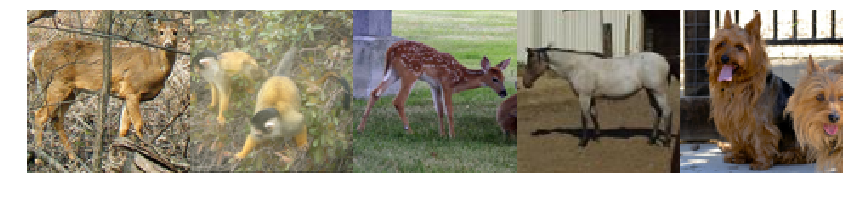

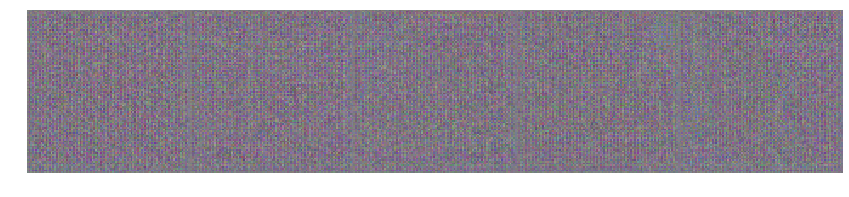

In [0]:
with torch.no_grad():
    images, _ = next(iter(dataloader))
    images = images.cuda()

    decoded, commit_loss = vqVAE.forward(images)
    print(images.shape, decoded.shape, commit_loss.item())

    show_images([b for b in images[:5].cpu()])
    show_images([b for b in decoded[:5].cpu()])

In [0]:
def vq_loss(decoded, original, commit_loss):
    loss_recon = (decoded - original).pow(2).mean() # criterion_perceptual(decoded, original)
    # loss_vq = (quantized_b - encoded_b.detach()).pow(2).mean() + (quantized_t - encoded_t.detach()).pow(2).mean()
    
    return loss_recon + commit_loss * 0.25, loss_recon

169452032
EPOCH 1 (1000/2500) - loss 0.0010459357133950106 - recon 0.0007406914083112496 - commit 0.001220977216551546


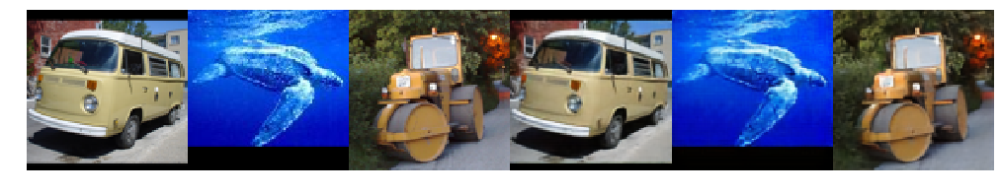

169452032
EPOCH 1 (2000/2500) - loss 0.0010467417960753663 - recon 0.0007420065360784065 - commit 0.0012189410375722219


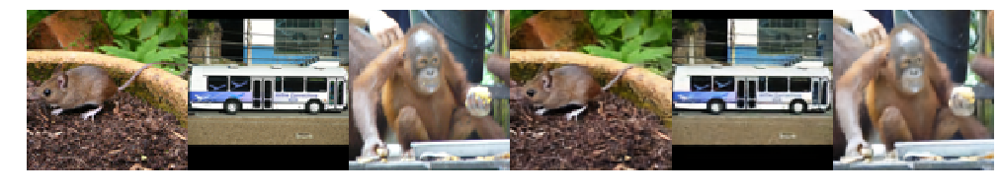

169452032
EPOCH 1 (2500/2500) - loss 0.0010421282846946268 - recon 0.0007386685829726048 - commit 0.001213838804117404


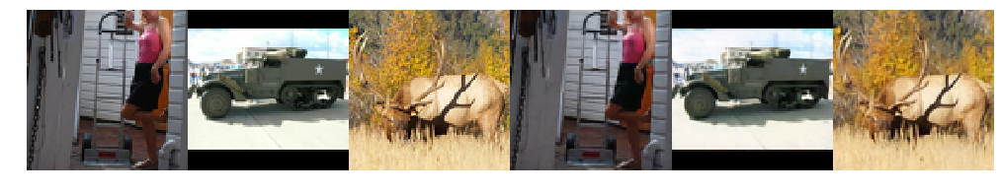

169452032
EPOCH 2 (1000/2500) - loss 0.0010040138146141543 - recon 0.0007166462010936811 - commit 0.001149470454605762


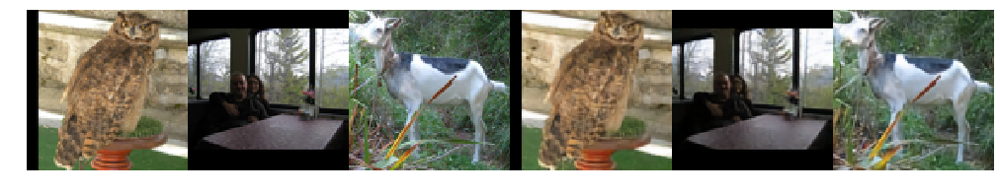

169452032
EPOCH 2 (2000/2500) - loss 0.0009964250434422864 - recon 0.0007112091657472774 - commit 0.0011408635085099377


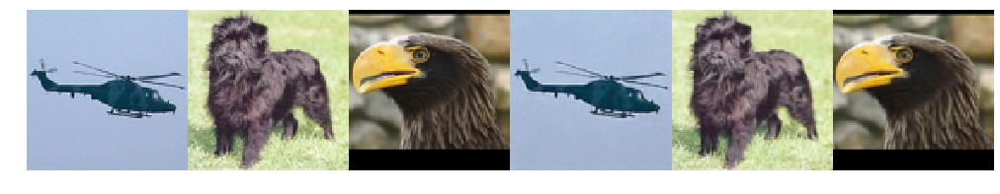

169452032
EPOCH 2 (2500/2500) - loss 0.001002602752367966 - recon 0.0007162650144891813 - commit 0.0011453509490704165


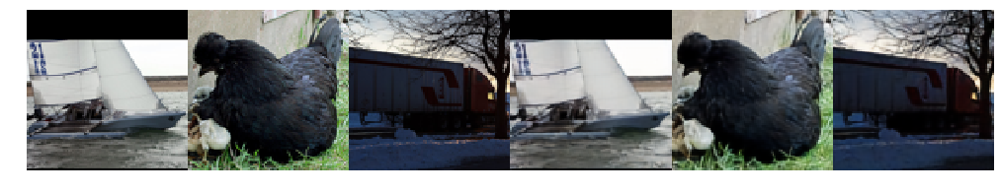

169452032
EPOCH 3 (1000/2500) - loss 0.0009860352025134488 - recon 0.0007046114879485685 - commit 0.0011256948612863198


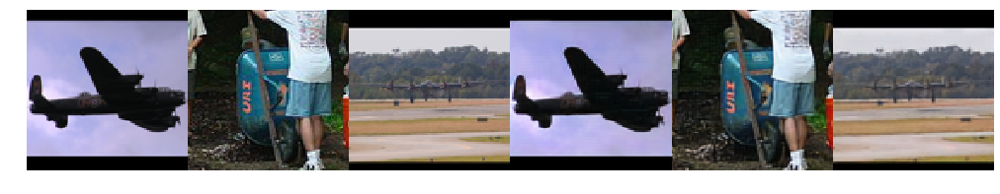

169452032
EPOCH 3 (2000/2500) - loss 0.0009924014294811058 - recon 0.0007084994123579235 - commit 0.0011356080697732978


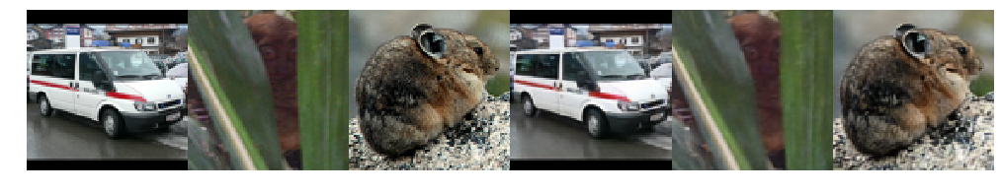

169452032
EPOCH 3 (2500/2500) - loss 0.0009859711703611538 - recon 0.0007038190023624338 - commit 0.0011286086722044274


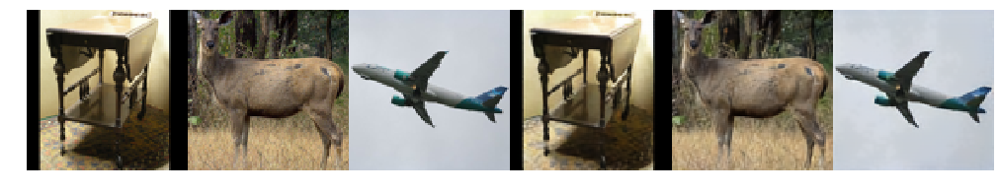

169452032
EPOCH 4 (1000/2500) - loss 0.0009487040900858119 - recon 0.0006784331894887145 - commit 0.0010810836048331112


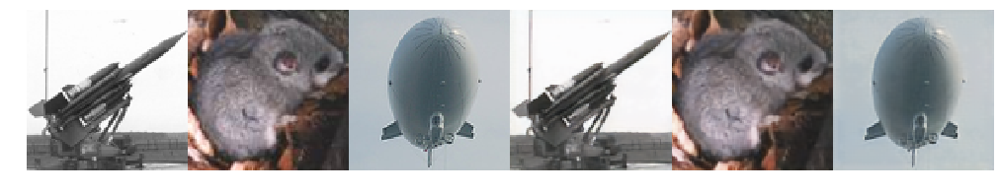

169452032
EPOCH 4 (2000/2500) - loss 0.0009668796609039418 - recon 0.0006906010475213407 - commit 0.0011051144592638593


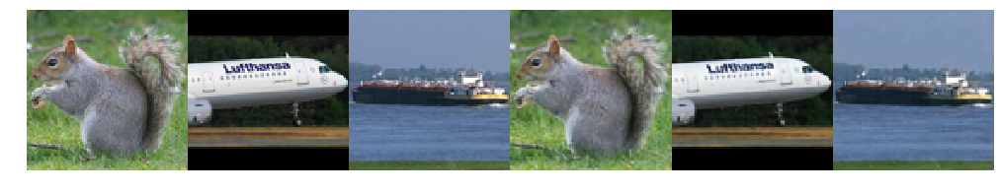

169452032
EPOCH 4 (2500/2500) - loss 0.0009633074552286416 - recon 0.0006884766188450157 - commit 0.001099323350423947


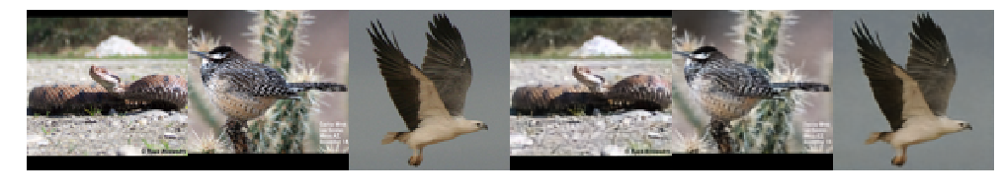

169452032
EPOCH 5 (1000/2500) - loss 0.0009344304400146939 - recon 0.0006714941255340818 - commit 0.0010517452559433878


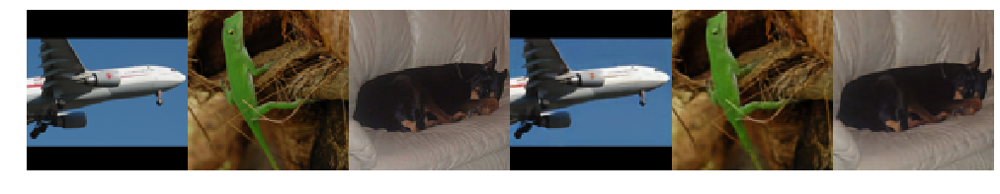

169452032
EPOCH 5 (2000/2500) - loss 0.0009436831335478928 - recon 0.0006773836436186684 - commit 0.0010651979616377503


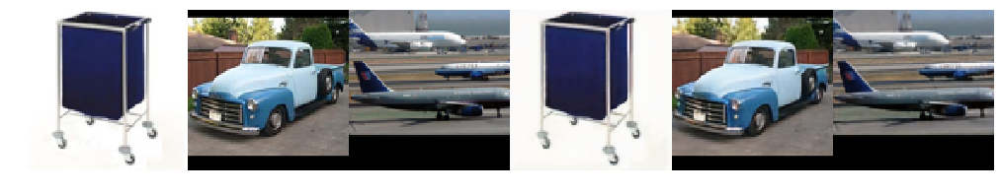

169452032
EPOCH 5 (2500/2500) - loss 0.000947199552692473 - recon 0.0006797012671711855 - commit 0.0010699931443436071


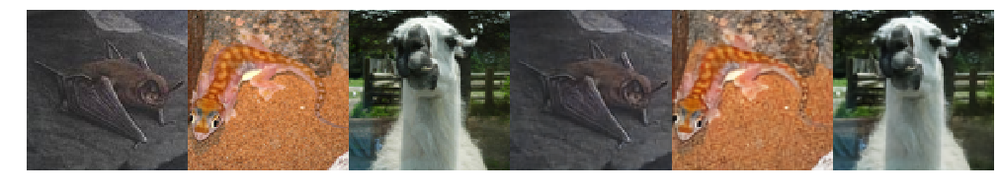

In [0]:
optimizer = optim.Adam(vqVAE.parameters(), lr=0.0002)
epochs = 5
print_every = 1000

vqVAE.cuda()
for e in range(1, epochs+1):
    total_loss = 0
    total_loss_recon = 0
    total_loss_commit = 0
    vqVAE.train()
    for batch, (images, _) in enumerate(dataloader):
        images = images.cuda()
        
        decoded, commit_loss = vqVAE.forward(images)  
        loss, recon_loss = vq_loss(decoded, images, commit_loss)
        
        total_loss += loss.item()
        total_loss_recon += recon_loss.item()
        total_loss_commit += commit_loss.item()
        
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        
        if (batch+1) % print_every == 0 or (batch+1) == len(dataloader):
            print(torch.cuda.memory_allocated())
            print(f"EPOCH {e} ({batch+1}/{len(dataloader)}) - loss {total_loss/(batch+1)} - recon {total_loss_recon/(batch+1)} - commit {total_loss_commit/(batch+1)}")
            show_images([b for b in images[:3].cpu()] + [b for b in decoded[:3].cpu().detach()])

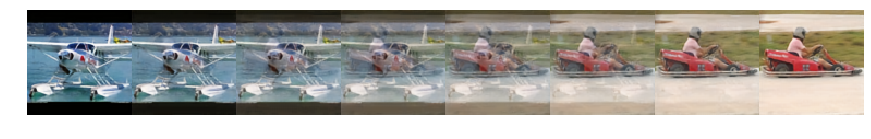

In [0]:
vqVAE.eval()
with torch.no_grad():
    images, _ = next(iter(dataloader))
    images = images.cuda()

    qb, qt, _, _, _  = vqVAE.encode(images)
    
    inter_samples = 6
    
    inter_samples += 1 # ignore this, if we want 3 samples it's easier if this value is 4
    
    def interpolate_bottom(a, b, ammount):
        a, b = a.permute(0, 2, 3, 1), b.permute(0, 2, 3, 1)
        e = a*(1 - ammount)+b*(ammount)
        q, _, _ = vqVAE.vquantizer_bottom(e) 
        q = q.permute(0, 3, 1, 2)
        return q
    
    def interpolate_top(a, b, ammount):
        a, b = a.permute(0, 2, 3, 1), b.permute(0, 2, 3, 1)
        e = a*(1 - ammount)+b*(ammount)
        q, _, _ = vqVAE.vquantizer_top(e) 
        q = q.permute(0, 3, 1, 2)
        return q
    
    decoded_aq = vqVAE.decode(qb[0:1], qt[0:1])[0]
    decoded_bq = vqVAE.decode(qb[1:2], qt[1:2])[0]
    decoded_ab = [vqVAE.decode(interpolate_bottom(qb[0:1], qb[1:2], i/inter_samples), interpolate_top(qt[0:1], qt[1:2], i/inter_samples))[0].cpu() for i in range(1, inter_samples)]
    
    show_images([
        decoded_aq.cpu(),
        *decoded_ab, 
        decoded_bq.cpu()
    ])

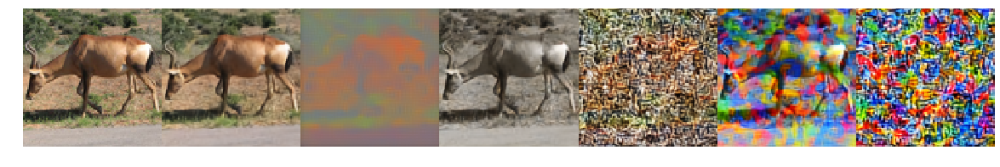

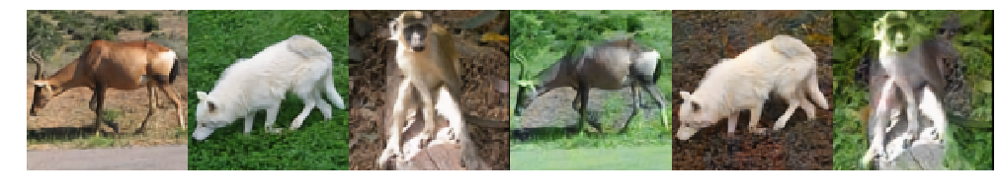

In [0]:
vqVAE.eval()
with torch.no_grad():
    images, _ = next(iter(dataloader))
    images = images.cuda()
    
    decoded, _ = vqVAE.forward(images)
    qb, qt, _, _, _ = vqVAE.encode(images)
    
    random_prior_b = torch.randn_like(qb).permute(0, 2, 3, 1).cuda()
    random_prior_t = torch.randn_like(qt).permute(0, 2, 3, 1).cuda()

    q_random_b, _, _ = vqVAE.vquantizer_bottom(random_prior_b) 
    q_random_b = q_random_b.permute(0, 3, 1, 2)
    
    q_random_t, _, _ = vqVAE.vquantizer_top(random_prior_t) 
    q_random_t = q_random_t.permute(0, 3, 1, 2)

    decoded_base = vqVAE.decode(qb, qt)
    decoded_random_b = vqVAE.decode(q_random_b, qt)
    decoded_random_t = vqVAE.decode(qb, q_random_t)
    decoded_random_bt = vqVAE.decode(q_random_b, q_random_t)
    
    decoded_random_zb = vqVAE.decode(torch.zeros_like(qb), qt)
    decoded_random_zt = vqVAE.decode(qb, torch.zeros_like(qt))
    
    decoded_mixed = vqVAE.decode(qb[:-1], qt[1:])
    
    show_images([
        images[0].cpu(), 
        decoded_base.cpu()[0],
        decoded_random_zb.cpu()[0],
        decoded_random_zt.cpu()[0],
        decoded_random_b.cpu()[0],
        decoded_random_t.cpu()[0],
        decoded_random_bt.cpu()[0],
    ])
    
    show_images([
        decoded_base.cpu()[0],
        decoded_base.cpu()[1],
        decoded_base.cpu()[2],
        decoded_mixed.cpu()[0],
        decoded_mixed.cpu()[1],
        decoded_mixed.cpu()[2],
    ])

In [0]:
torch.save(vqVAE.state_dict(), 'gdrive/My Drive/Colab Notebooks/models/vqvae2/model.pt')

In [0]:
vqVAE.load_state_dict(torch.load('gdrive/My Drive/Colab Notebooks/models/vqvae2/model_vqcolors.pt'))

IncompatibleKeys(missing_keys=[], unexpected_keys=[])

/usr/local/lib/python3.6/dist-packages/torchvision/transforms/functional.py:251: UserWarning: The use of the transforms.Scale transform is deprecated, please use transforms.Resize instead.
  "please use transforms.Resize instead.")


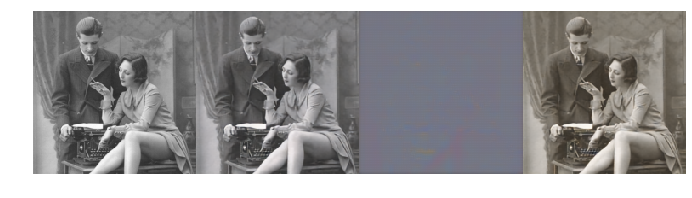

In [0]:
vqVAE.eval()

bw = Image.open("bw2.jpg").convert('L').convert('RGB')
bw = torchvision.transforms.functional.scale(bw, 192)
bw = torchvision.transforms.functional.to_tensor(bw)

with torch.no_grad():
    qb, qt, _, _, _ = vqVAE.encode(bw.cuda().unsqueeze(0))
    
    decoded = vqVAE.decode(qb, qt)
    decoded_b = vqVAE.decode(torch.zeros_like(qb), qt)
    decoded_t = vqVAE.decode(qb, torch.zeros_like(qt))

    show_images([bw, decoded.cpu()[0], decoded_b.cpu()[0], decoded_t.cpu()[0]])

In [0]:
for param in vqVAE.parameters():
    param.requires_grad = False

In [0]:
# let's try to learn the distribution from one latent vector to the other...

class Dom2Dom(nn.Module):
    def __init__(self):
        super(Dom2Dom, self).__init__()
        
        hidden_size = 256
        
        self.domdom = nn.Sequential(
            nn.ReflectionPad2d(1),
            nn.Conv2d(16, hidden_size, kernel_size=4, stride=2),
            nn.BatchNorm2d(hidden_size),
            nn.ReLU(),
            nn.ReflectionPad2d(1),
            nn.Conv2d(hidden_size, hidden_size, kernel_size=3),
            ResBlock(hidden_size),
            ResBlock(hidden_size),
            nn.Conv2d(hidden_size, 256, kernel_size=1),
        )
        
        self.apply(weights_init)
        
    def forward(self, x):
        return self.domdom(x)

In [0]:
torch.cuda.empty_cache()

In [0]:
dom2Dom = Dom2Dom()
dom2Dom.cuda()
optimizer = optim.Adam(dom2Dom.parameters(), lr=0.0001, betas=(0.5, 0.999))
criterion = nn.CrossEntropyLoss(reduction='sum')

87496192
EPOCH 1 (500/2500) - loss 46372.2488984375


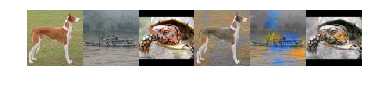

88638976
EPOCH 1 (1000/2500) - loss 45622.86944921875


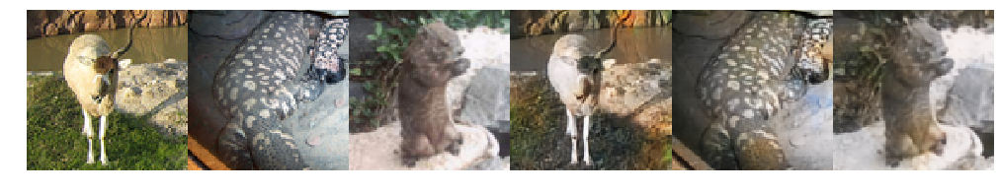

88638976
EPOCH 1 (1500/2500) - loss 45217.31033854167


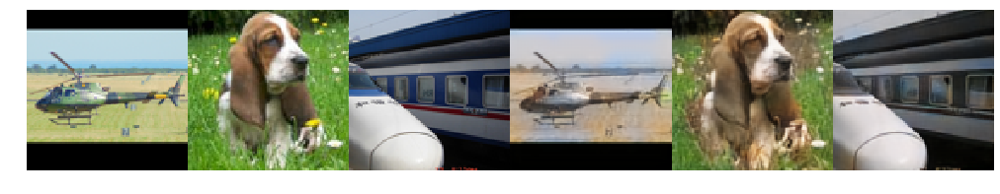

88638976
EPOCH 1 (2000/2500) - loss 44916.326734375


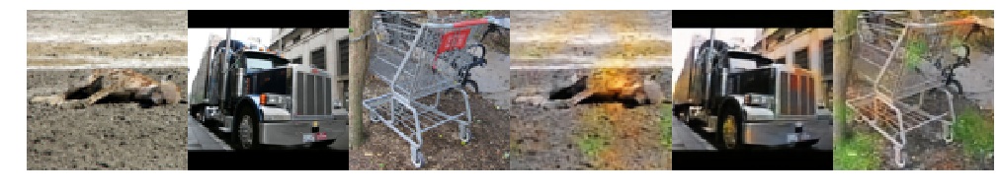

88049152
EPOCH 1 (2500/2500) - loss 44680.538265625


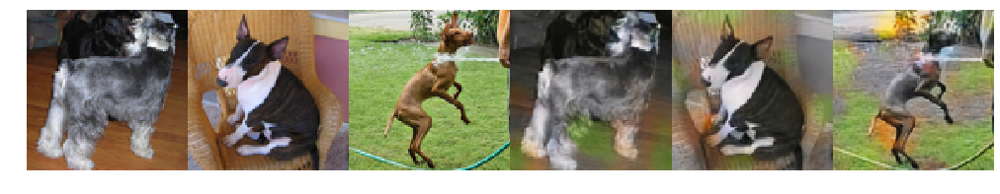

88442368
EPOCH 2 (500/2500) - loss 43430.335359375


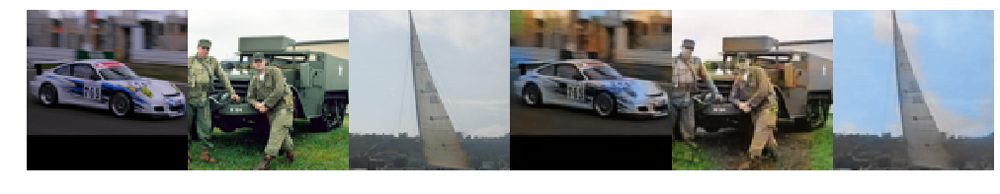

88049152
EPOCH 2 (1000/2500) - loss 43354.07687109375


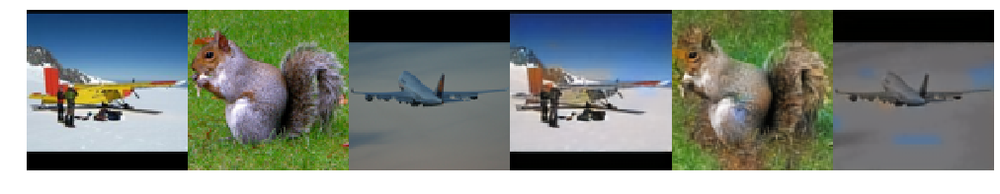

88442368
EPOCH 2 (1500/2500) - loss 43267.276427083336


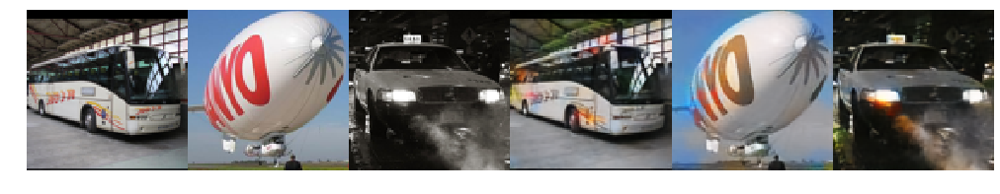

88049152
EPOCH 2 (2000/2500) - loss 43208.63711132813


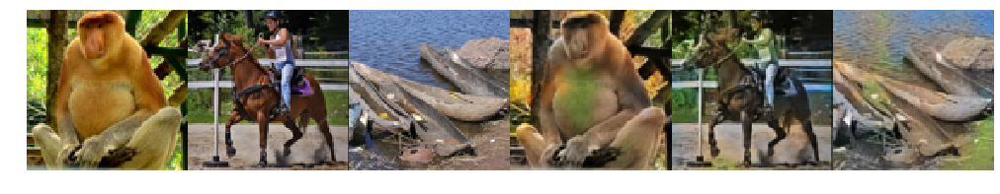

In [0]:
epochs = 10
print_every = 500

vqVAE.eval()
for e in range(1, epochs+1):
    total_loss = 0
    for batch, (images, _) in enumerate(dataloader):
        images = images.cuda()
        with torch.no_grad():
            _, _, _, ib, it = vqVAE.encode(images)
            ib, it = ib.detach(), it.detach()
            qb = vqVAE.vquantizer_bottom.codebook(ib).detach()
                    
        pred = dom2Dom.forward(qb.permute(0, 3, 1, 2)).permute(0, 2, 3, 1)
        loss = criterion(pred.contiguous().view(-1, 256), it.view(-1))
        
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        
        total_loss += loss.item()
        
        if (batch+1) % print_every == 0 or (batch+1) == len(dataloader):
            print(torch.cuda.memory_allocated())
            print(f"EPOCH {e} ({batch+1}/{len(dataloader)}) - loss {total_loss/(batch+1)}")
            
            with torch.no_grad():
                pred = pred.argmax(dim=-1)
                qt_gen = vqVAE.vquantizer_top.codebook(pred).detach()
                decoded = vqVAE.decode(qb.permute(0, 3, 1, 2), qt_gen.permute(0, 3, 1, 2))
            
            show_images([b for b in images[:3].cpu()] + [b for b in decoded[:3].cpu().detach()])

In [0]:
vqVAE.eval()
dom2Dom.eval()

bw = Image.open("bw2.jpg").convert('L').convert('RGB')
bw = torchvision.transforms.functional.scale(bw, 96)
bw = torchvision.transforms.functional.to_tensor(bw).unsqueeze(0)

# bw = images[0:1]

with torch.no_grad():
    qb, qt, _, _, _ = vqVAE.encode(bw.cuda())    
    pred = dom2Dom.forward(qb).permute(0, 2, 3, 1)
    pred = pred.argmax(dim=-1)  
    qt_gen = vqVAE.vquantizer_top.codebook(pred).detach()
    
    recolor = vqVAE.decode(qb, qt_gen.permute(0, 3, 1, 2))

    show_images([bw.cpu()[0], recolor.cpu()[0]])

In [0]:
# mini GAN to learn priors!!!
class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        
        self.generator = nn.Sequential(          
            nn.ConvTranspose2d(1, 256, kernel_size=4, padding=1, stride=2),
            nn.BatchNorm2d(256),
            nn.ReLU(),
            nn.Conv2d(256, 256, kernel_size=3, padding=1),
            nn.BatchNorm2d(256),
            nn.ReLU(),
            nn.Conv2d(256, 256, kernel_size=3, padding=1),
            nn.BatchNorm2d(256),
            nn.ReLU(),
            nn.Conv2d(256, 8, kernel_size=3, padding=1),
        )
        
    def forward(self, x):
        return self.generator(x)
        
class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        
        self.discriminator = nn.Sequential(          
            nn.Conv2d(8, 64, kernel_size=3, padding=1, stride=2),
            nn.BatchNorm2d(64),
            nn.ReLU(),
            nn.Conv2d(64, 64, kernel_size=3, padding=1),
            nn.BatchNorm2d(64),
            nn.ReLU()
        )
        
        self.classifier = nn.Sequential(
            nn.Linear(12*12*64, 1),
            nn.Sigmoid()
        )
        
    def forward(self, x):
        return self.classifier(self.discriminator(x).view(x.size(0), -1))

In [0]:
generator = Generator()
discriminator = Discriminator()
generator.cuda(), discriminator.cuda()

(Generator(
   (generator): Sequential(
     (0): ConvTranspose2d(1, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
     (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
     (2): ReLU()
     (3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
     (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
     (5): ReLU()
     (6): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
     (7): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
     (8): ReLU()
     (9): Conv2d(256, 8, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
   )
 ), Discriminator(
   (discriminator): Sequential(
     (0): Conv2d(8, 64, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
     (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
     (2): ReLU()
     (3): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
     

EPOCH 1 - gen 0.6530144512653351 - disc 1.463794481009245


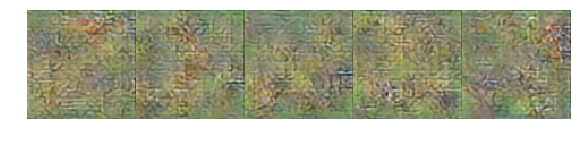

EPOCH 2 - gen 0.6645134538412094 - disc 1.4692346528172493


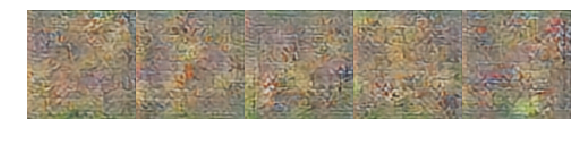

EPOCH 3 - gen 0.6780637502670288 - disc 1.4462637677788734


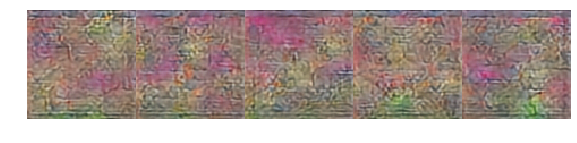

EPOCH 4 - gen 0.6964144166558981 - disc 1.4196166656911373


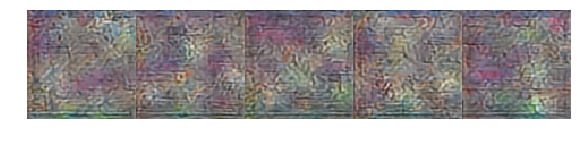

EPOCH 5 - gen 0.717319916933775 - disc 1.3832432851195335


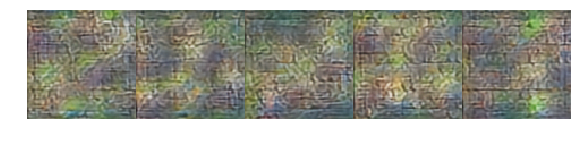

EPOCH 6 - gen 0.7114342674612999 - disc 1.4011782743036747


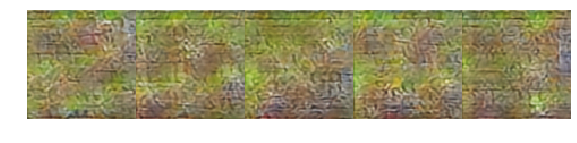

EPOCH 7 - gen 0.7346871327608824 - disc 1.351466502994299


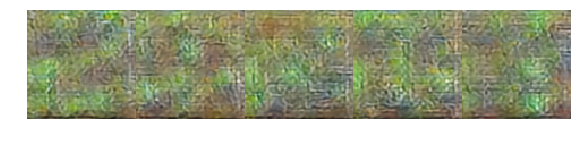

EPOCH 8 - gen 0.7348341532051563 - disc 1.3521656654775143


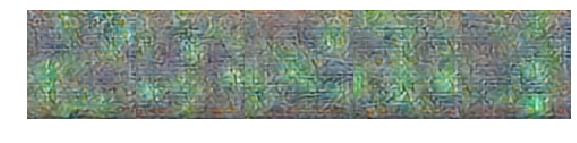

EPOCH 9 - gen 0.7510385606437922 - disc 1.3383678086102009


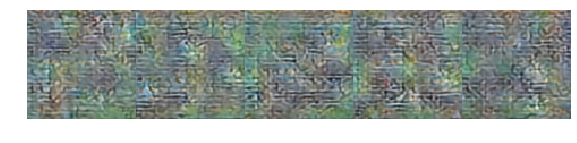

EPOCH 10 - gen 0.7578645646572113 - disc 1.3292887918651104


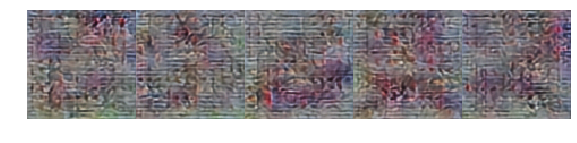

EPOCH 11 - gen 0.7714061439037323 - disc 1.309788566082716


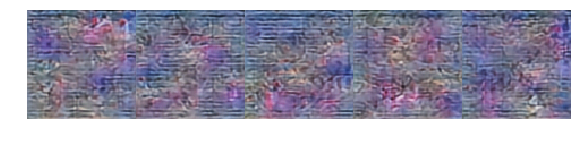

EPOCH 12 - gen 0.7820011582225561 - disc 1.307342380285263


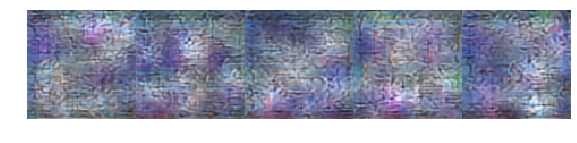

EPOCH 13 - gen 0.792393522337079 - disc 1.2986570857465267


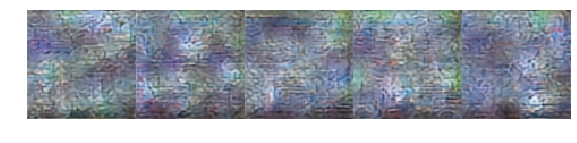

EPOCH 14 - gen 0.7969482690095901 - disc 1.289990697056055


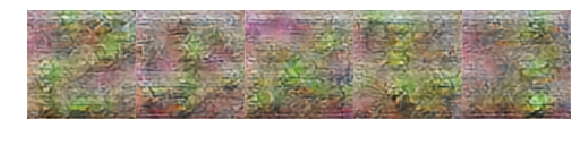

EPOCH 15 - gen 0.8228998426347971 - disc 1.231582399457693


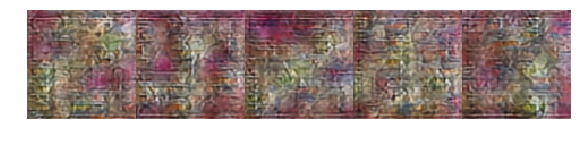

EPOCH 16 - gen 0.7579801846295595 - disc 1.3339704163372517


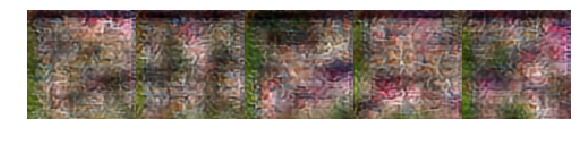

EPOCH 17 - gen 0.8144760802388191 - disc 1.2688387483358383


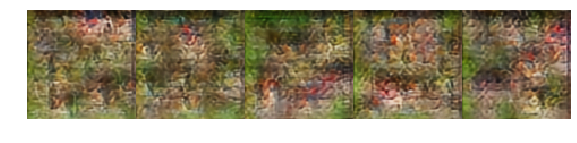

EPOCH 18 - gen 0.8254549968987703 - disc 1.2481878362596035


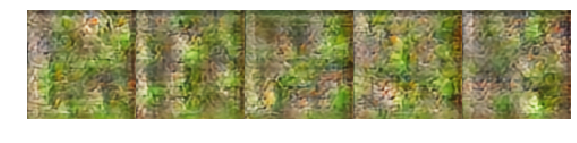

EPOCH 19 - gen 0.8323966022580862 - disc 1.251321416348219


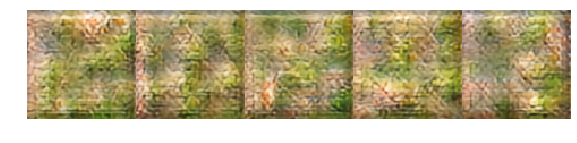

EPOCH 20 - gen 0.8349185008555651 - disc 1.242585651576519


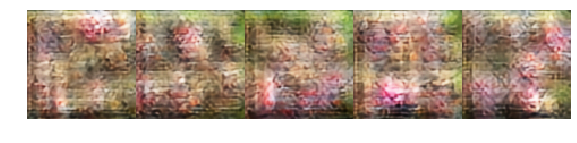

EPOCH 21 - gen 0.8336056768894196 - disc 1.251654900610447


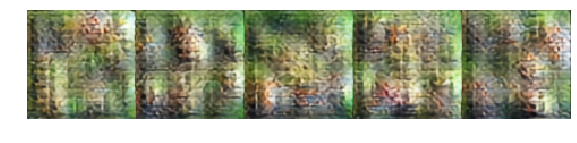

EPOCH 22 - gen 0.8291277177631855 - disc 1.2505748271942139


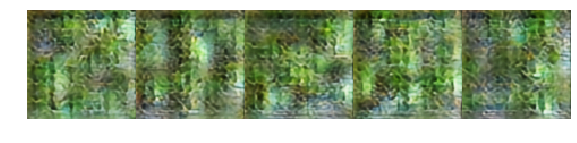

EPOCH 23 - gen 0.8700990378856659 - disc 1.1956768333911896


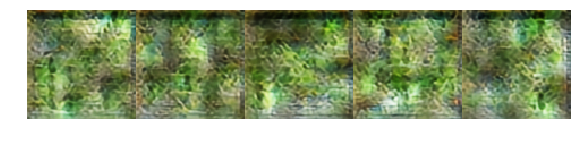

EPOCH 24 - gen 0.8529280349612236 - disc 1.2169693522155285


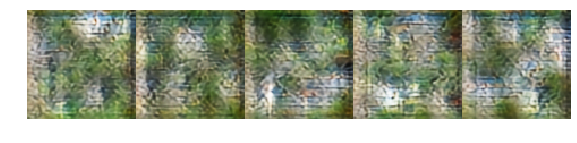

EPOCH 25 - gen 0.8635914232581854 - disc 1.2331785261631012


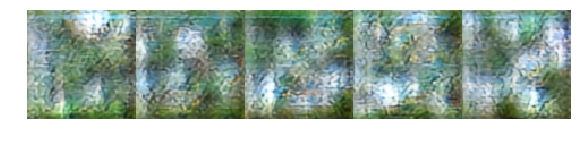

EPOCH 26 - gen 0.8572735786437988 - disc 1.2389757744967937


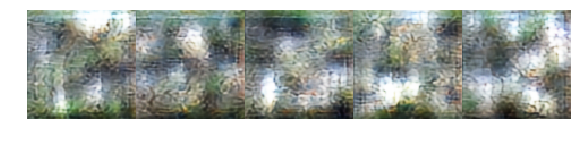

EPOCH 27 - gen 0.8417316488921642 - disc 1.2501622065901756


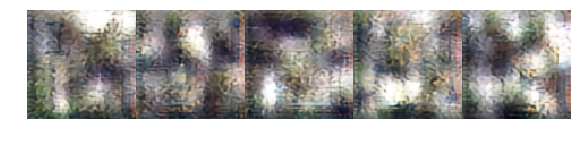

EPOCH 28 - gen 0.8582301586866379 - disc 1.2152624726295471


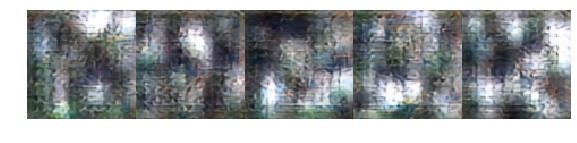

EPOCH 29 - gen 0.8320914041250944 - disc 1.2351037971675396


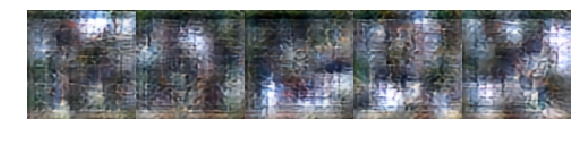

EPOCH 30 - gen 0.8657432980835438 - disc 1.2147867493331432


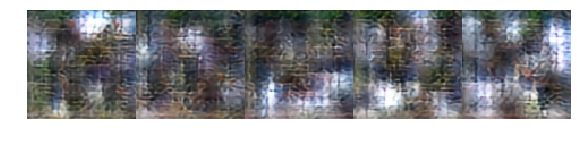

EPOCH 31 - gen 0.8446990419179201 - disc 1.214849203824997


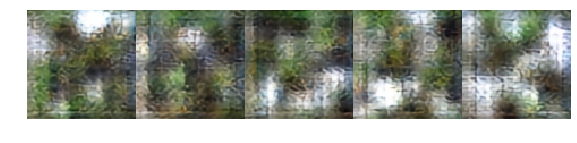

EPOCH 32 - gen 0.8477290831506252 - disc 1.253551546484232


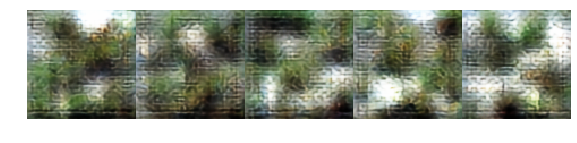

EPOCH 33 - gen 0.8671177346259356 - disc 1.2199274525046349


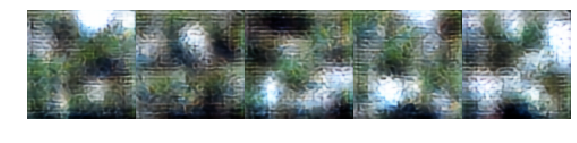

EPOCH 34 - gen 0.8676503989845514 - disc 1.2085498087108135


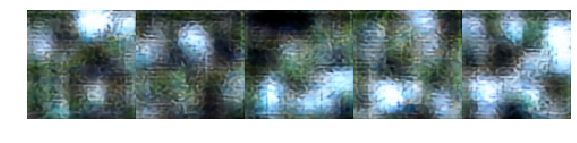

EPOCH 35 - gen 0.8177440334111452 - disc 1.261427152901888


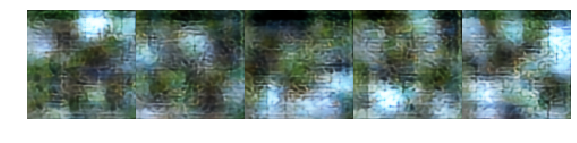

EPOCH 36 - gen 0.8505358416587114 - disc 1.2165548764169216


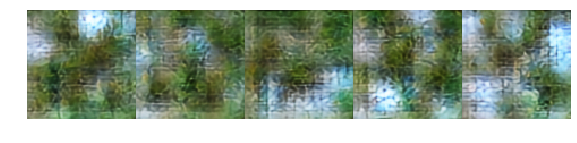

EPOCH 37 - gen 0.8602442182600498 - disc 1.2209605649113655


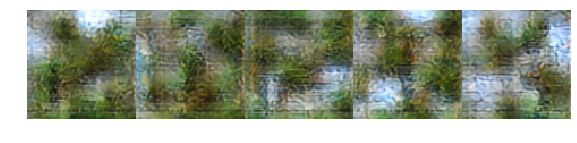

EPOCH 38 - gen 0.8659008033573627 - disc 1.2149907425045967


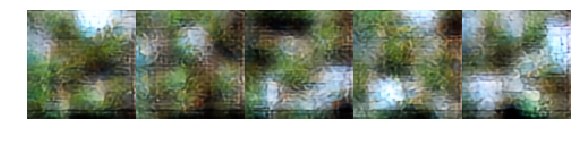

EPOCH 39 - gen 0.8769527077674866 - disc 1.2230358831584454


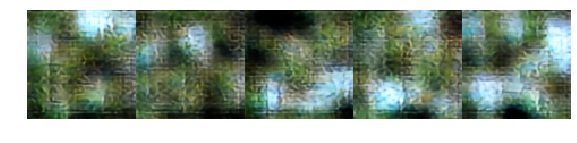

EPOCH 40 - gen 0.8818420432507992 - disc 1.1878712475299835


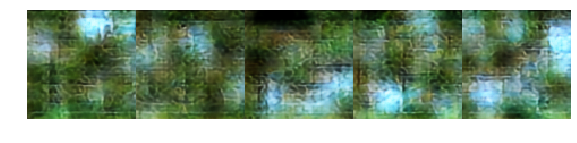

EPOCH 41 - gen 0.8655471652746201 - disc 1.2024780288338661


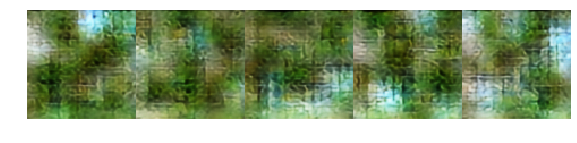

EPOCH 42 - gen 0.8736765198409557 - disc 1.1873555816709995


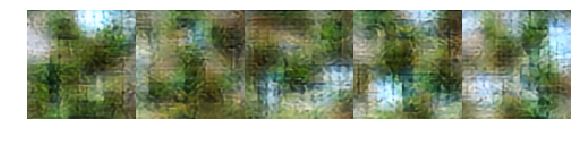

EPOCH 43 - gen 0.8577963002026081 - disc 1.2141021005809307


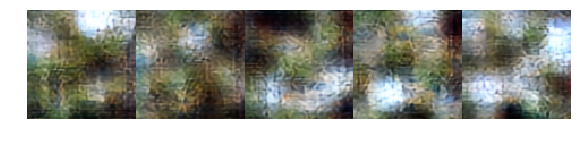

EPOCH 44 - gen 0.8782140258699656 - disc 1.2019446305930614


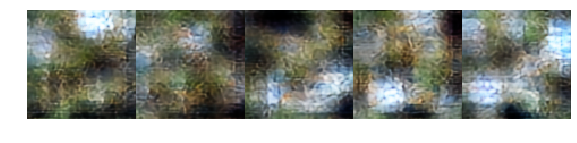

EPOCH 45 - gen 0.8845747783780098 - disc 1.177027404308319


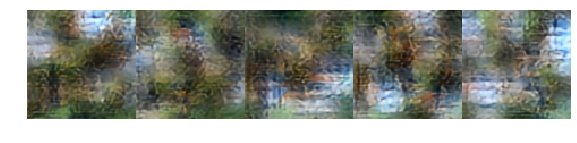

EPOCH 46 - gen 0.8578985594213009 - disc 1.1933778934180737


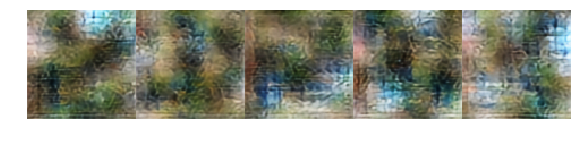

EPOCH 47 - gen 0.8986184857785702 - disc 1.1604804396629333


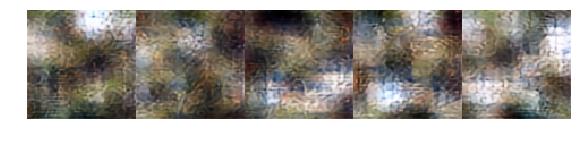

EPOCH 48 - gen 0.8837805595248938 - disc 1.1729869209229946


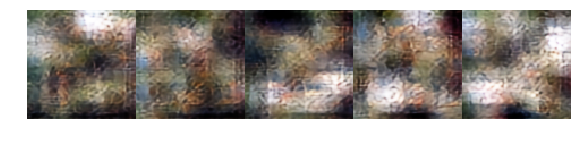

EPOCH 49 - gen 0.9156392216682434 - disc 1.1387691497802734


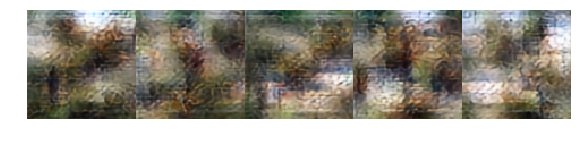

EPOCH 50 - gen 0.8924807216972113 - disc 1.1543134897947311


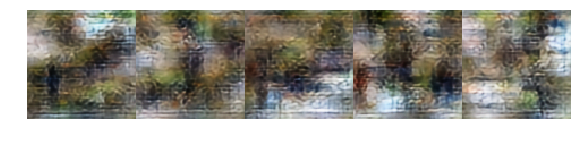

EPOCH 51 - gen 0.9107021614909172 - disc 1.1455444283783436


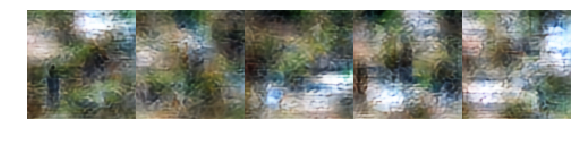

EPOCH 52 - gen 0.9027686472982168 - disc 1.1640668250620365


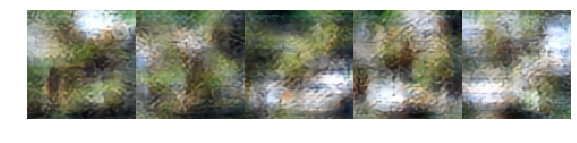

EPOCH 53 - gen 0.9259122163057327 - disc 1.1408494375646114


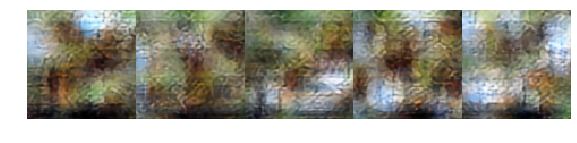

EPOCH 54 - gen 0.9065536465495825 - disc 1.1584800332784653


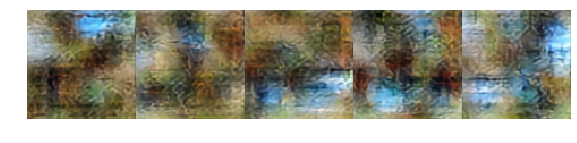

EPOCH 55 - gen 0.923806119710207 - disc 1.1519862115383148


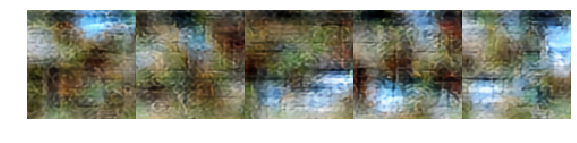

EPOCH 56 - gen 0.9275311306118965 - disc 1.1063927486538887


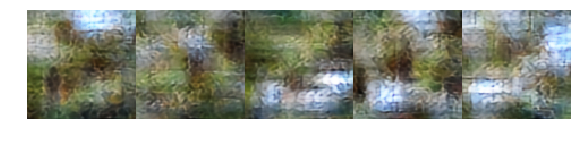

EPOCH 57 - gen 0.9304922204464674 - disc 1.1510800793766975


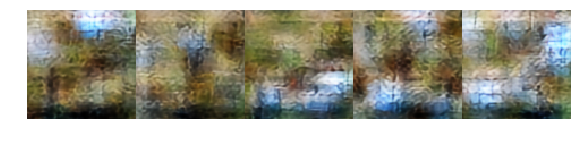

EPOCH 58 - gen 0.9532162621617317 - disc 1.104384507983923


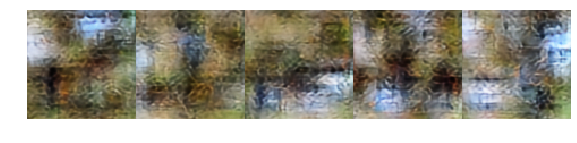

EPOCH 59 - gen 0.9176778141409159 - disc 1.126405157148838


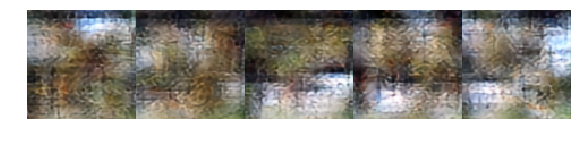

EPOCH 60 - gen 0.9645465854555368 - disc 1.0847964026033878


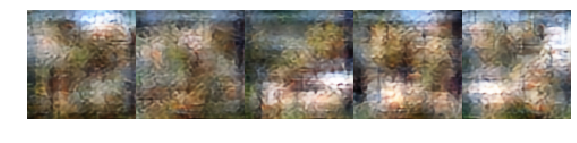

EPOCH 61 - gen 0.9503735899925232 - disc 1.1106529235839844


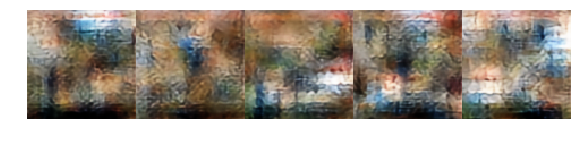

EPOCH 62 - gen 0.9623799100518227 - disc 1.0930026918649673


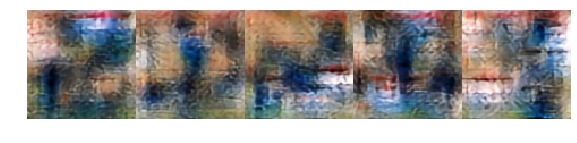

EPOCH 63 - gen 0.9778355471789837 - disc 1.0586039870977402


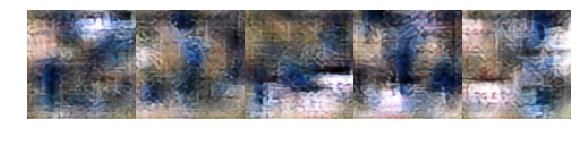

EPOCH 64 - gen 0.9726695194840431 - disc 1.0718722827732563


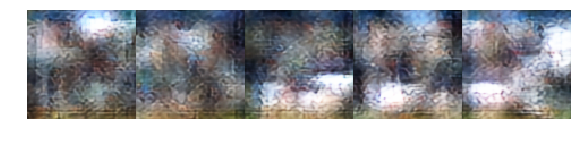

EPOCH 65 - gen 0.9726626090705395 - disc 1.0924653932452202


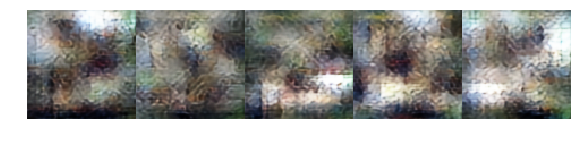

EPOCH 66 - gen 1.0253239795565605 - disc 1.068004185333848


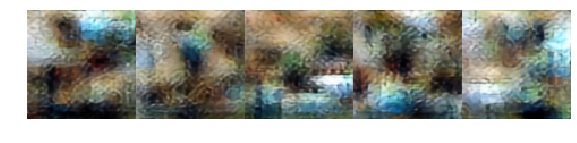

EPOCH 67 - gen 0.9740027114748955 - disc 1.0880329236388206


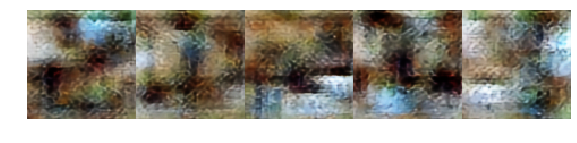

EPOCH 68 - gen 0.9781712330877781 - disc 1.0787127558141947


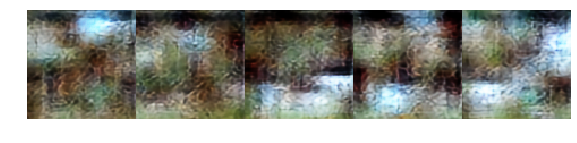

EPOCH 69 - gen 0.9947641268372536 - disc 1.0745941381901503


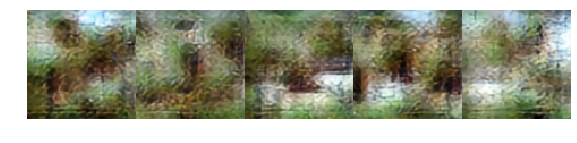

EPOCH 70 - gen 0.9837866425514221 - disc 1.0899957213550806


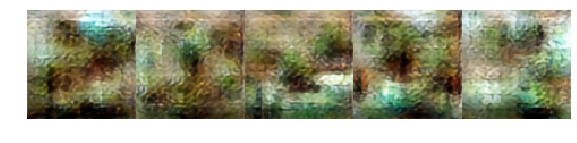

EPOCH 71 - gen 1.0366822928190231 - disc 1.0621517952531576


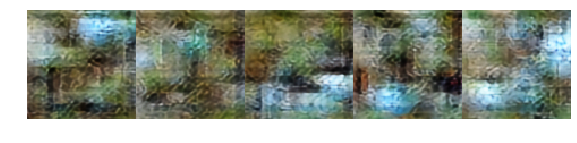

EPOCH 72 - gen 0.9685453940182924 - disc 1.0903935190290213


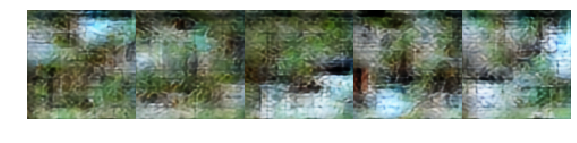

EPOCH 73 - gen 1.0189049169421196 - disc 1.0265615675598383


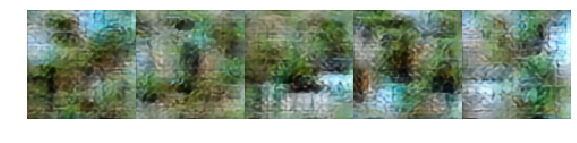

EPOCH 74 - gen 0.9799947515130043 - disc 1.0782121792435646


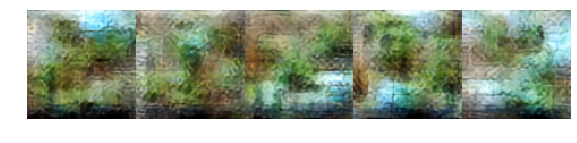

EPOCH 75 - gen 1.0472466945648193 - disc 1.0460873376578093


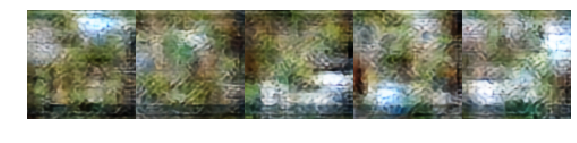

EPOCH 76 - gen 0.9987852666527033 - disc 1.0559652280062437


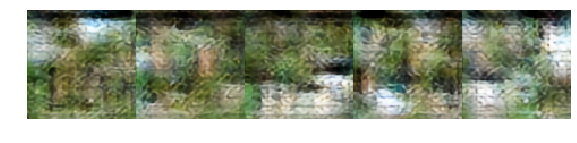

EPOCH 77 - gen 1.0028382297605276 - disc 1.0372400414198637


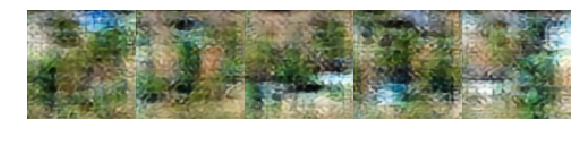

EPOCH 78 - gen 1.0184859447181225 - disc 1.0144415143877268


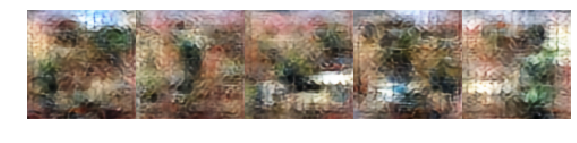

EPOCH 79 - gen 1.0267440099269152 - disc 1.0333285946398973


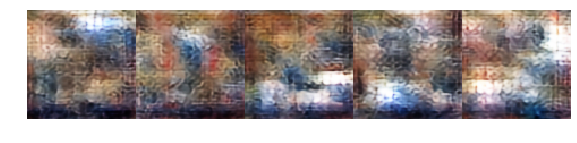

EPOCH 80 - gen 1.0494814403355122 - disc 1.0122030805796385


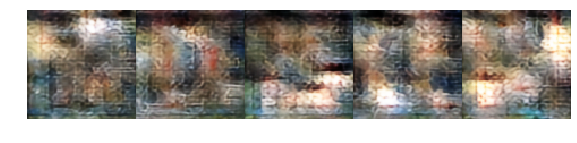

EPOCH 81 - gen 1.081546489149332 - disc 0.969452602788806


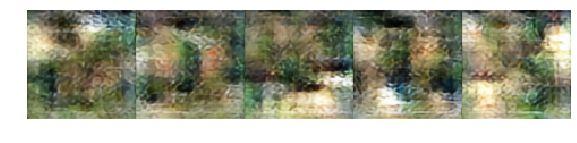

EPOCH 82 - gen 1.0269106291234493 - disc 1.018653141334653


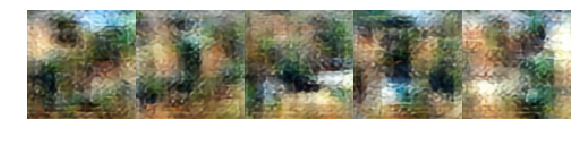

EPOCH 83 - gen 1.0445323754101992 - disc 1.02564911916852


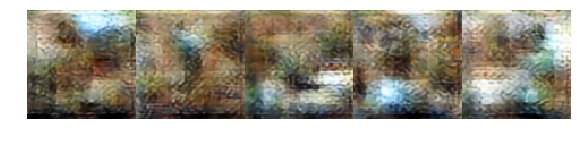

EPOCH 84 - gen 1.0849930010735989 - disc 1.0193086564540863


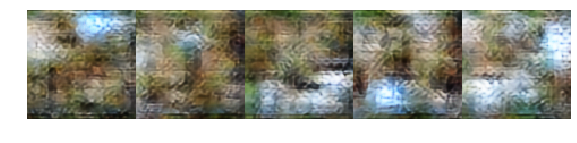

EPOCH 85 - gen 1.0155715011060238 - disc 1.0697373524308205


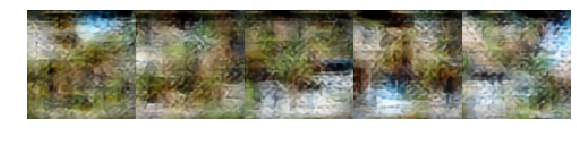

EPOCH 86 - gen 1.0652911067008972 - disc 0.9934530016034842


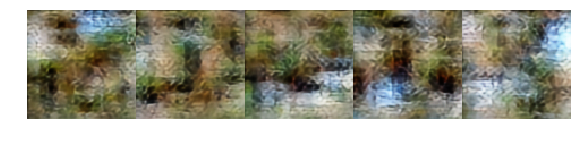

EPOCH 87 - gen 1.031419314444065 - disc 1.0293205305933952


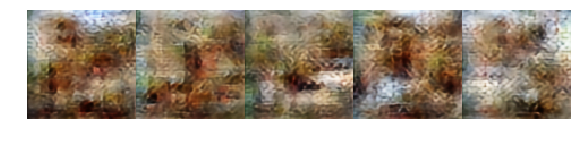

EPOCH 88 - gen 1.0966361872851849 - disc 0.983974352478981


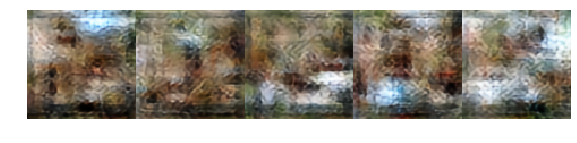

EPOCH 89 - gen 1.0772363916039467 - disc 0.9860394764691591


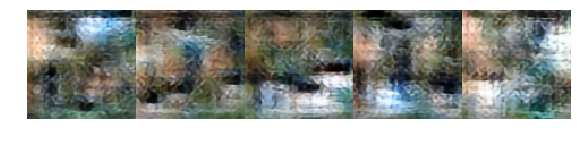

EPOCH 90 - gen 1.054342346265912 - disc 0.9945239871740341


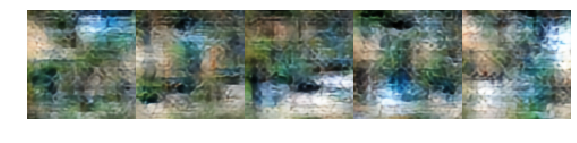

EPOCH 91 - gen 1.0740911830216646 - disc 0.9716547224670649


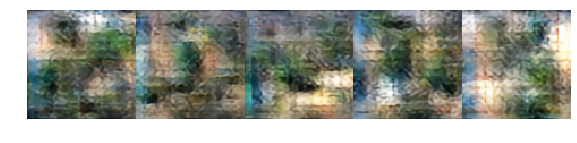

EPOCH 92 - gen 1.0803752429783344 - disc 0.9668794311583042


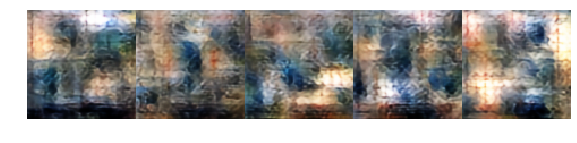

EPOCH 93 - gen 1.1691174320876598 - disc 0.8994932007044554


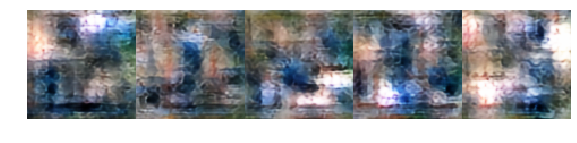

EPOCH 94 - gen 1.0657248608767986 - disc 0.9571825340390205


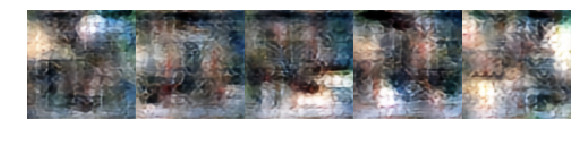

EPOCH 95 - gen 1.1144747287034988 - disc 0.949652872979641


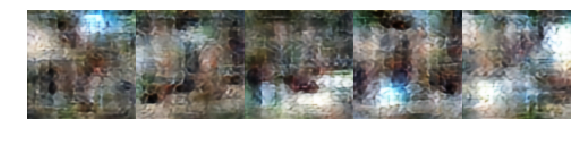

EPOCH 96 - gen 1.076706126332283 - disc 0.9972876738756895


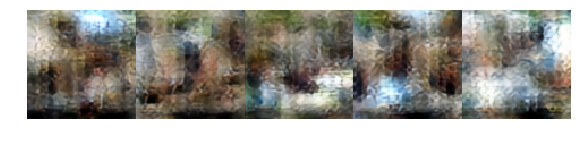

EPOCH 97 - gen 1.1073765978217125 - disc 0.9988613165915012


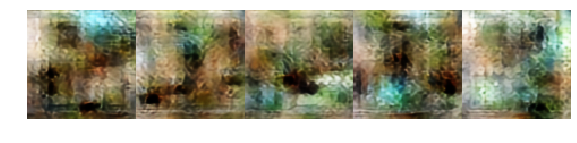

EPOCH 98 - gen 1.110148636624217 - disc 0.9510716218501329


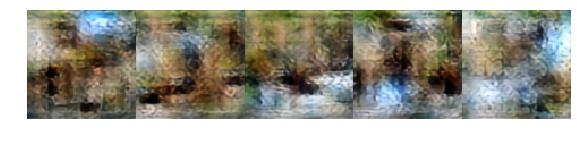

EPOCH 99 - gen 1.0687724463641644 - disc 1.0037222262471914


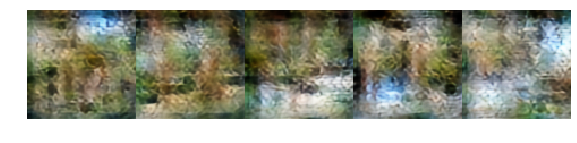

EPOCH 100 - gen 1.1341983936727047 - disc 0.9483837094157934


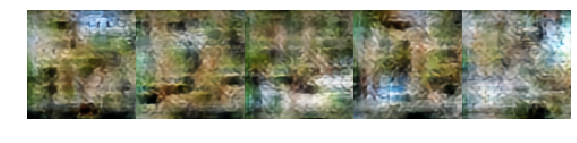

In [0]:
optimizer_gen = optim.Adam(generator.parameters(), lr=0.00002, betas=(0.5, 0.999))
optimizer_disc = optim.Adam(discriminator.parameters(), lr=0.00002, betas=(0.5, 0.999))

epochs = 100

fixed_noise = torch.randn(5, 1, 12, 12).cuda()

criterion = nn.BCELoss()

for e in range(1, epochs+1):
    total_loss_gen = 0
    total_loss_disc = 0
    for images, _ in dataloader:
        images = images.cuda()        
        with torch.no_grad():
            _, q, _ = vqVAE.encode(images)
            q = q.detach()
        
        noise = torch.randn(q.size(0), 1, 12, 12).cuda()
        
        # first train the discriminator    
        d_real = discriminator(q)
        d_real_loss = criterion(d_real, torch.ones_like(d_real))
        
        d_gen = discriminator(generator(noise))
        d_gen_loss = criterion(d_gen, torch.zeros_like(d_gen))
        
        d_loss = d_real_loss + d_gen_loss
        total_loss_disc += d_loss.item()
        
        optimizer_disc.zero_grad()
        d_loss.backward()
        optimizer_disc.step()
        
        # then train the generator
        g_gen = discriminator(generator(noise))
        g_loss = criterion(g_gen, torch.ones_like(g_gen))
        total_loss_gen += g_loss.item()
        
        optimizer_gen.zero_grad()
        g_loss.backward()
        optimizer_gen.step()
    
    with torch.no_grad():
        generated = generator(fixed_noise).detach().permute(0, 2, 3, 1)
        q_encoded, _ = vqVAE.vquantizer(generated.contiguous().view(-1, generated.size(-1))) 
        q_encoded = q_encoded.contiguous().view(generated.shape).permute(0, 3, 1, 2)
        decoded = vqVAE.decode(q_encoded)
        
    print(f"EPOCH {e} - gen {total_loss_gen/len(dataloader)} - disc {total_loss_disc/len(dataloader)}")
    show_images([d.cpu() for d in decoded])

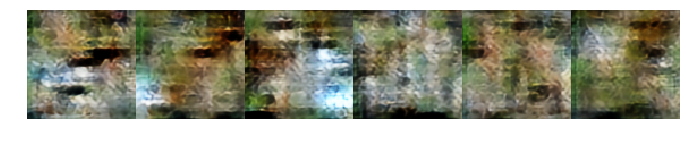

In [0]:
noise = torch.randn(6, 1, 12, 12).cuda()
with torch.no_grad():
    generator.eval()
    generated = generator(noise).detach().permute(0, 2, 3, 1)
    q_encoded, _ = vqVAE.vquantizer(generated.contiguous().view(-1, generated.size(-1))) 
    q_encoded = q_encoded.contiguous().view(generated.shape).permute(0, 3, 1, 2)
    decoded = vqVAE.decode(q_encoded)
    generator.train()
    
show_images([d.cpu() for d in decoded])